In [1]:
!pip install transformers
# !pip install sentencepiece
# !pip3 install mvlearn
# !pip install POT

from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [8]:
!pip install transformers


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.7 MB 4.9 MB/s 
     |████████████████████████████████| 596 kB 18.9 MB/s 
     |████████████████████████████████| 101 kB 9.2 MB/s 
     |████████████████████████████████| 6.6 MB 36.8 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [2]:
import os
os.chdir('drive/MyDrive/William_2022/DATASETS/trans_encoder_2_KEMO')

In [9]:
import torch
from torch.utils.data import DataLoader, Dataset, WeightedRandomSampler
import pandas as pd
import numpy as np
from model_new import Transformer, Transformer2, Encoder
from config import *
from imblearn.over_sampling import RandomOverSampler
from transformers import AutoTokenizer
from sklearn.model_selection import train_test_split
import torch.nn as nn
import torch.nn.functional as F
import tqdm
from tqdm import tqdm
from optim_new import ScheduledOptim
from torch.optim import Adam
from sklearn.metrics import confusion_matrix
# from CCA import DeepCCA, cca_loss
from scipy.stats import wasserstein_distance
# from mvlearn.embed import DCCA
# from mvlearn.datasets import make_gaussian_mixture
# from mvlearn.plotting import crossviews_plot
# from dataset_new import Fusion
import matplotlib.pylab as plt
# import ot
# import ot.plot
# from mvlearn.plotting import quick_visualize
from sklearn.manifold import TSNE
from numpy import reshape
import seaborn as sns

In [13]:
df = pd.read_csv('df.csv')

X = df.drop([emotion], axis = 1)
y= df[[emotion]]

X_train, X_val, y_train, y_val = train_test_split(X, y, random_state = 2, test_size = 0.3, shuffle = True, stratify = y)
ros = RandomOverSampler(random_state=2)
X_resampled_text, y_resampled_text = ros.fit_resample(X_train, y_train)



X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, random_state= 2, test_size = 0.5, shuffle = True, stratify = y_val)
df_test = pd.concat([X_test, y_test], axis = 1)
df_train = pd.concat([X_resampled_text, y_resampled_text], axis = 1)
# df_train = pd.concat([X_train, y_train], axis = 1)
df_train = df_train.sample(frac=1).reset_index(drop=True)
df_val = pd.concat([X_val, y_val], axis = 1)

df_train_text = df_train[[emotion, 'new_words']]
df_train_eeg = df_train[eeg]

df_val_text = df_val[[emotion, 'new_words']]
df_val_eeg = df_val[eeg]

df_test_text = df_test[[emotion, 'new_words']]
df_test_eeg = df_test[eeg]


In [16]:
# --- Save CSV
df_train_text.to_csv('df_train_text.csv', header = None, index = False, index_label = False)
df_train_eeg.to_csv('df_train_eeg.csv', header = None, index = False, index_label = False)

df_val_text.to_csv('df_val_text.csv', header = None, index = False, index_label = False)
df_val_eeg.to_csv('df_val_eeg.csv', header = None, index = False, index_label=False)


df_test_text.to_csv('df_test_text.csv', header = None, index = False, index_label = False)
df_test_eeg.to_csv('df_test_eeg.csv', header = None, index = False, index_label=False)

# --- Load CSV
df_train_text = pd.read_csv('df_train_text.csv', header = None).values
df_train_eeg = pd.read_csv('df_train_eeg.csv', header = None).values

df_val_text= pd.read_csv('df_val_text.csv', header = None).values
df_val_eeg = pd.read_csv('df_val_eeg.csv', header = None).values

df_test_text= pd.read_csv('df_test_text.csv', header = None).values
df_test_eeg = pd.read_csv('df_test_eeg.csv', header = None).values

In [14]:
tokenizer = AutoTokenizer.from_pretrained(PRE_TRAINED_MODEL_NAME)

sentences_train = df_train_text.new_words
sentences_val = df_val_text.new_words
sentences_test = df_test_text.new_words

input_ids_train = [tokenizer.encode(sent, add_special_tokens=False,max_length=MAX_LEN,pad_to_max_length=True, return_token_type_ids = False, return_attention_mask = True) for sent in sentences_train]
input_ids_val = [tokenizer.encode(sent, add_special_tokens=False,max_length=MAX_LEN,pad_to_max_length=True, return_token_type_ids = False, return_attention_mask = True) for sent in sentences_val]
input_ids_test = [tokenizer.encode(sent, add_special_tokens=False,max_length=MAX_LEN,pad_to_max_length=True, return_token_type_ids = False, return_attention_mask = True) for sent in sentences_test]


Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
/usr/local/lib/python3.7/dist-packages/transformers/tokenization_utils_base.py:2329: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  FutureWarning,


In [15]:
import scipy.stats as stats

input_ids_train = np.array(input_ids_train)
input_ids_train = stats.zscore(input_ids_train, axis=None, nan_policy='omit')

input_ids_val = np.array(input_ids_val)
input_ids_val = stats.zscore(input_ids_val, axis=None, nan_policy='omit')

input_ids_test = np.array(input_ids_test)
input_ids_test = stats.zscore(input_ids_test, axis=None, nan_policy='omit')

In [17]:
# --- load ZuCo sentence

#normal

X_train_text = np.loadtxt('baselines/text/arousal_trans_baseline_onlytext_all_pred_train.txt')

y_train_text = np.loadtxt('baselines/text/arousal_trans_baseline_onlytext_all_label_train.txt')

X_train_eeg = np.loadtxt('baselines/eeg/arousal_trans_baseline_onlyeeg_all_pred_train.txt')

y_train_eeg = np.loadtxt('baselines/eeg/arousal_trans_baseline_onlyeeg_all_label_train.txt')

#fusion

X_train_fusion = np.loadtxt('baselines/text_eeg_fusion/arousal_trans_baseline_fusion_linout_all_pred_train.txt')

y_train_fusion = np.loadtxt('baselines/text_eeg_fusion/arousal_trans_baseline_fusion_linout_all_label_train.txt')


#DCCA fusion

X_train_DCCA_fusion = np.loadtxt('baselines/DCCA_fusion/arousal_trans_baseline_DCCA_fusion_trans_all_pred_train.txt')

y_train_DCCA_fusion = np.loadtxt('baselines/DCCA_fusion/arousal_trans_baseline_DCCA_fusion_trans_all_label_train.txt')

#DCCA ds

X_train_DCCA_ds_text = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlytext_trans_all_pred_train.txt')

y_train_DCCA_ds_text = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlytext_trans_all_label_train.txt')

X_train_DCCA_ds_eeg = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlyeeg_trans_all_pred_train.txt')

y_train_DCCA_ds_eeg = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlyeeg_trans_all_label_train.txt')


#WD fusion

X_train_WD_fusion = np.loadtxt('baselines/fusion_wd/arousal_trans_baseline_fusion_wd_trans_all_pred_train.txt')

y_train_WD_fusion = np.loadtxt('baselines/fusion_wd/arousal_trans_baseline_fusion_wd_trans_all_label_train.txt')

#WD ds

X_train_WD_ds_text = np.loadtxt('baselines/fusion_wd_ds/arousal_trans_baseline_fusion_wd_text_trans_all_pred_train.txt')

y_train_WD_ds_text = np.loadtxt('baselines/fusion_wd_ds/arousal_trans_baseline_fusion_wd_text_trans_all_label_train.txt')

X_train_WD_ds_eeg = np.loadtxt('baselines/fusion_wd_ds/arousal_trans_baseline_fusion_wd_eeg_trans_all_pred_train.txt')

y_train_WD_ds_eeg = np.loadtxt('baselines/fusion_wd_ds/arousal_trans_baseline_fusion_wd_eeg_trans_all_label_train.txt')



#CS fusion

X_train_CS_fusion = np.loadtxt('baselines/fusion_cossim/arousal_trans_baseline_fusion_cossim_trans_all_pred_train.txt')

y_train_CS_fusion = np.loadtxt('baselines/fusion_cossim/arousal_trans_baseline_fusion_cossim_trans_all_label_train.txt')

#CS ds

X_train_CS_ds_text = np.loadtxt('baselines/fusion_cossim_ds/arousal_trans_baseline_fusion_cossim_text_trans_all_pred_train.txt')

y_train_CS_ds_text = np.loadtxt('baselines/fusion_cossim_ds/arousal_trans_baseline_fusion_cossim_text_trans_all_label_train.txt')

X_train_CS_ds_eeg = np.loadtxt('baselines/fusion_cossim_ds/arousal_trans_baseline_fusion_cossim_eeg_trans_all_pred_train.txt')

y_train_CS_ds_eeg = np.loadtxt('baselines/fusion_cossim_ds/arousal_trans_baseline_fusion_cossim_eeg_trans_all_label_train.txt')


In [ ]:
X_train_DCCA_ds_text = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlytext_trans_all_pred_train.txt')

y_train_DCCA_ds_text = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlytext_trans_all_label_train.txt')

X_train_DCCA_ds_eeg = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlyeeg_trans_all_pred_train.txt')

y_train_DCCA_ds_eeg = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlyeeg_trans_all_label_train.txt')

X_train_CS_ds_text = np.loadtxt('baselines/fusion_cossim_ds/arousal_trans_baseline_fusion_cossim_text_trans_all_pred_train.txt')

y_train_CS_ds_text = np.loadtxt('baselines/fusion_cossim_ds/arousal_trans_baseline_fusion_cossim_text_trans_all_label_train.txt')

X_train_CS_ds_eeg = np.loadtxt('baselines/fusion_cossim_ds/arousal_trans_baseline_fusion_cossim_eeg_trans_all_pred_train.txt')

y_train_CS_ds_eeg = np.loadtxt('baselines/fusion_cossim_ds/arousal_trans_baseline_fusion_cossim_eeg_trans_all_label_train.txt')

In [ ]:
X_train_CS_fusion = np.loadtxt('baselines/fusion_cossim/arousal_trans_baseline_fusion_cossim_trans_all_pred_train.txt')

y_train_CS_fusion = np.loadtxt('baselines/fusion_cossim/arousal_trans_baseline_fusion_cossim_trans_all_label_train.txt')

In [4]:
#DCCA fusion

X_train_DCCA_fusion = np.loadtxt('baselines/DCCA_fusion/arousal_trans_baseline_DCCA_fusion_trans_all_pred_train.txt')

y_train_DCCA_fusion = np.loadtxt('baselines/DCCA_fusion/arousal_trans_baseline_DCCA_fusion_trans_all_label_train.txt')

#DCCA ds

X_train_DCCA_ds_text = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlytext_trans_all_pred_train.txt')

y_train_DCCA_ds_text = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlytext_trans_all_label_train.txt')

X_train_DCCA_ds_eeg = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlyeeg_trans_all_pred_train.txt')

y_train_DCCA_ds_eeg = np.loadtxt('baselines/DCCA_ds/arousal_trans_baseline_onlyeeg_trans_all_label_train.txt')



#raw

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 2181 samples in 0.000s...
[t-SNE] Computed neighbors for 2181 samples in 0.203s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2181
[t-SNE] Computed conditional probabilities for sample 2000 / 2181
[t-SNE] Computed conditional probabilities for sample 2181 / 2181
[t-SNE] Mean sigma: 0.420595
[t-SNE] KL divergence after 250 iterations with early exaggeration: 72.807663
[t-SNE] KL divergence after 5000 iterations: 0.029736


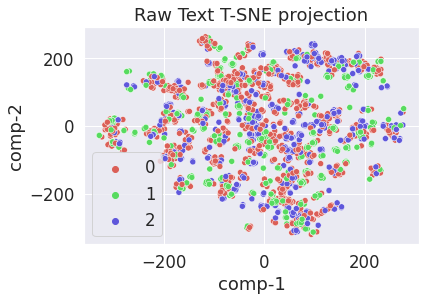

In [18]:
#norm text
x = input_ids_train
y = df_train_text[:, 0]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()
df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="Raw Text T-SNE projection") 

plt.savefig('rawtext_tsne.png', bbox_inches="tight")

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 2181 samples in 0.000s...
[t-SNE] Computed neighbors for 2181 samples in 0.154s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2181
[t-SNE] Computed conditional probabilities for sample 2000 / 2181
[t-SNE] Computed conditional probabilities for sample 2181 / 2181
[t-SNE] Mean sigma: 1.311418
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.455353
[t-SNE] KL divergence after 5000 iterations: 0.445220


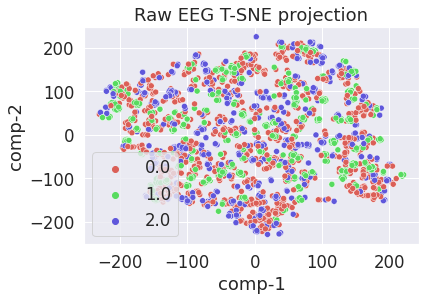

In [19]:
#norm EEG
x =df_train_eeg[:, 1:]
y = df_train_eeg[:, 0]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()
df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)


sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="Raw EEG T-SNE projection") 

plt.savefig('raweeg_tsne.png', bbox_inches="tight")

# CE

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.228786
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.963184
[t-SNE] KL divergence after 5000 iterations: 0.472742


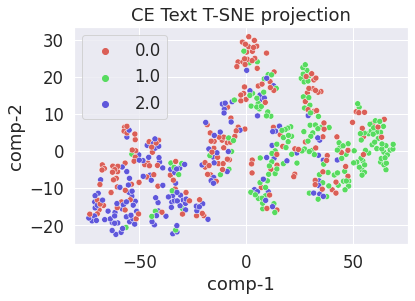

In [20]:
#CE text
x = X_train_text[435700:]
y = y_train_text[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()
df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)


sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="CE Text T-SNE projection")

plt.savefig('CE_text.png', bbox_inches="tight")

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.009s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.352407
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.627876
[t-SNE] KL divergence after 5000 iterations: 0.556180


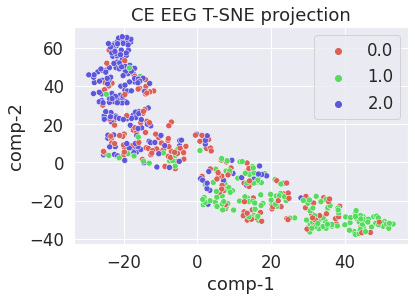

In [21]:
#CE eeg
x = X_train_eeg[435700:]
y = y_train_eeg[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)


sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="CE EEG T-SNE projection")
plt.savefig('CE_EEG.png', bbox_inches="tight") 

# Fusion

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.009s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.658677
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.843819
[t-SNE] KL divergence after 1950 iterations: 0.437085


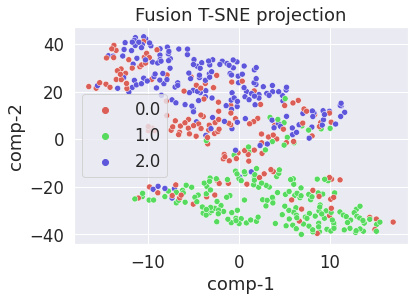

In [22]:
#fusion
x = X_train_fusion[435700:]
y = y_train_fusion[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 30, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="Fusion T-SNE projection") 
plt.savefig('fusion_tsne.png', bbox_inches="tight")

# DCCA

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.000s...
[t-SNE] Computed neighbors for 500 samples in 0.005s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 49.323433
[t-SNE] KL divergence after 3650 iterations: 0.279607


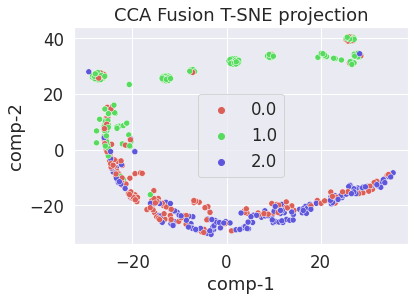

In [23]:
#DCCA Fusion
x = X_train_DCCA_fusion[435700:]
y = y_train_DCCA_fusion[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="CCA Fusion T-SNE projection")
plt.savefig('DCCA_fusion.png', bbox_inches="tight") 

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.337367
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.125340
[t-SNE] KL divergence after 4450 iterations: 0.593253


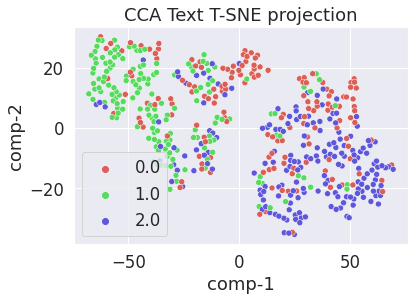

In [24]:
#DCCA DS
x = X_train_DCCA_ds_text[435700:]
y = y_train_DCCA_ds_text[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="CCA Text T-SNE projection")
plt.savefig('DCCA_text.png', bbox_inches="tight") 

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 76 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.439460
[t-SNE] KL divergence after 250 iterations with early exaggeration: 55.174194
[t-SNE] KL divergence after 3950 iterations: 0.486027


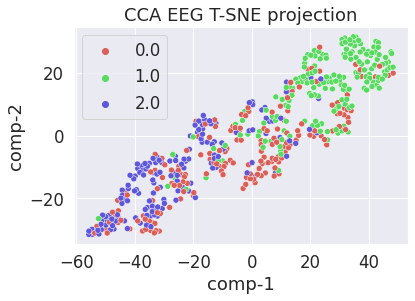

In [25]:
#DCCA DS
x = X_train_DCCA_ds_eeg[435700:]
y = y_train_DCCA_ds_eeg[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 25, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="CCA EEG T-SNE projection")

plt.savefig('DCCA_eeg.png', bbox_inches="tight") 

# WD

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.010s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.003594
[t-SNE] KL divergence after 250 iterations with early exaggeration: 54.582001
[t-SNE] KL divergence after 2800 iterations: 0.364419


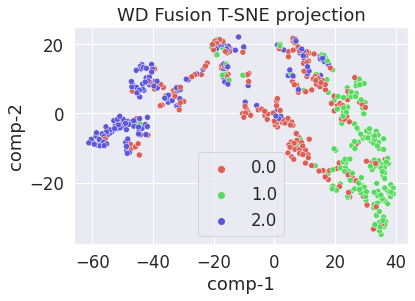

In [26]:
#WD Fusion
x = X_train_WD_fusion[435700:]
y = y_train_WD_fusion[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)


sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="WD Fusion T-SNE projection")
plt.savefig('WD_fusion.png', bbox_inches="tight") 

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.256818
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.975433
[t-SNE] KL divergence after 4400 iterations: 0.517301


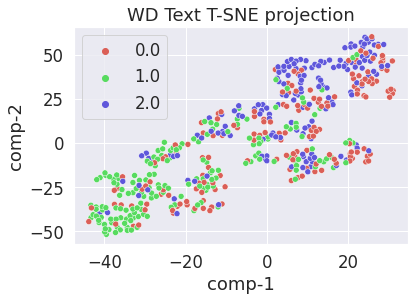

In [27]:
#WD DS
x = X_train_WD_ds_text[435700:]
y = y_train_WD_ds_text[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="WD Text T-SNE projection")
plt.savefig('WD_text.png', bbox_inches="tight") 

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.426681
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.008110
[t-SNE] KL divergence after 5000 iterations: 0.486593


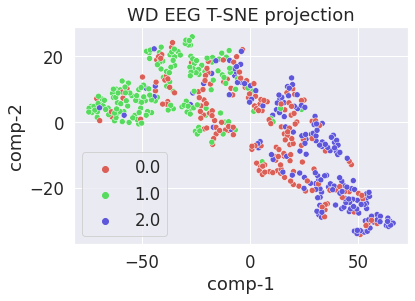

In [28]:
#WD DS
x = X_train_WD_ds_eeg[435700:]
y = y_train_WD_ds_eeg[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="WD EEG T-SNE projection")
plt.savefig('WD_eeg.png', bbox_inches="tight") 

# Cossim

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.000s...
[t-SNE] Computed neighbors for 500 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.349645
[t-SNE] KL divergence after 250 iterations with early exaggeration: 51.283035
[t-SNE] KL divergence after 5000 iterations: 0.312538


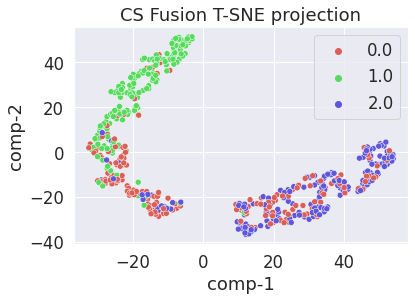

In [29]:
#Cossim fusion
x = X_train_CS_fusion[435700:]
y = y_train_CS_fusion[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="CS Fusion T-SNE projection")

plt.savefig('CS_fusion.png', bbox_inches="tight") 

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.636508
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.047562
[t-SNE] KL divergence after 5000 iterations: 0.517249


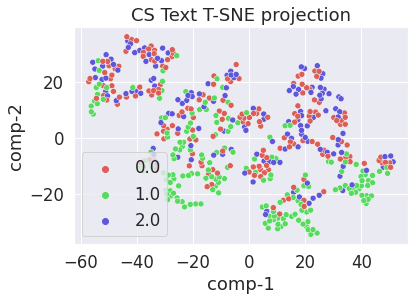

In [30]:
#Cossim DS
x = X_train_CS_ds_text[435700:]
y = y_train_CS_ds_text[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)


sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="CS Text T-SNE projection")
plt.savefig('CS_text.png', bbox_inches="tight") 

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 500 samples in 0.001s...
[t-SNE] Computed neighbors for 500 samples in 0.008s...
[t-SNE] Computed conditional probabilities for sample 500 / 500
[t-SNE] Mean sigma: 0.709092
[t-SNE] KL divergence after 250 iterations with early exaggeration: 58.551746
[t-SNE] KL divergence after 3750 iterations: 0.509464


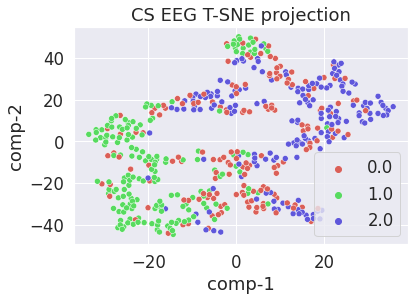

In [31]:
#Cossim DS
x = X_train_CS_ds_eeg[435700:]
y = y_train_CS_ds_eeg[435700:]

tsne = TSNE(n_components=2, verbose=1, random_state=42, perplexity = 20, n_iter = 5000, learning_rate = 'auto')
z = tsne.fit_transform(x) 
df = pd.DataFrame()

df["y"] = y
df["comp-1"] = z[:,0]
df["comp-2"] = z[:,1]
sns.set(font_scale=1.5)

sns.scatterplot(x="comp-1", y="comp-2", hue=df.y.tolist(),
                palette=sns.color_palette("hls", 3),
                data=df).set(title="CS EEG T-SNE projection") 
plt.savefig('CS_eeg.png', bbox_inches="tight")

# tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=runs_single_text

In [ ]:
%tensorboard --logdir=runs_single_eeg

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
%tensorboard --logdir=runs_fusion

Output hidden; open in https://colab.research.google.com to view.